## Loan Default Prediction 

In [2]:
# Import Modules
import numpy as np 
import pandas as pd 

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns


import warnings
warnings.filterwarnings('ignore')


# Jupyter Notebook Hack: This code ensures that the results of multiple commands within a given cell are all displayed, rather than just the last. 
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"



In [3]:
loan = pd.read_csv(r'E:\Learning\Interview Prep\ML_Artivatic_dataset\train_indessa.csv')
loantest = pd.read_csv(r'E:\Learning\Interview Prep\ML_Artivatic_dataset\test_indessa.csv')
loan.head()

,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,batch_enrolled,int_rate,grade,sub_grade,emp_title,...,collections_12_mths_ex_med,mths_since_last_major_derog,application_type,verification_status_joint,last_week_pay,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
0,58189336,14350,14350,14350.0,36 months,,19.19,E,E3,clerk,...,0.0,74.0,INDIVIDUAL,NaN,26th week,0.0,0.0,28699.0,30800.0,0
1,70011223,4800,4800,4800.0,36 months,BAT1586599,10.99,B,B4,Human Resources Specialist,...,0.0,NaN,INDIVIDUAL,NaN,9th week,0.0,0.0,9974.0,32900.0,0
2,70255675,10000,10000,10000.0,36 months,BAT1586599,7.26,A,A4,Driver,...,0.0,NaN,INDIVIDUAL,NaN,9th week,0.0,65.0,38295.0,34900.0,0
3,1893936,15000,15000,15000.0,36 months,BAT4808022,19.72,D,D5,Us office of Personnel Management,...,0.0,NaN,INDIVIDUAL,NaN,135th week,0.0,0.0,55564.0,24700.0,0
4,7652106,16000,16000,16000.0,36 months,BAT2833642,10.64,B,B2,LAUSD-HOLLYWOOD HIGH SCHOOL,...,0.0,NaN,INDIVIDUAL,NaN,96th week,0.0,0.0,47159.0,47033.0,0


In [237]:
loan.describe()

,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,mths_since_last_major_derog,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,5.324280e+05,532428.000000,532428.000000,532428.000000,532428.000000,5.324250e+05,532428.000000,532412.000000,532412.000000,259874.000000,82123.000000,532412.000000,532412.000000,5.324280e+05,532141.000000,532412.000000,532428.000000,532428.000000,532428.000000,532428.000000,532333.000000,132980.000000,532412.000000,490424.000000,4.904240e+05,4.904240e+05,532428.000000
mean,3.500547e+07,14757.595722,14744.271291,14704.926696,13.242969,7.502984e+04,18.138767,0.314448,0.694603,34.055735,70.093068,11.545594,0.194858,1.692128e+04,55.057189,25.267357,1753.428788,0.394954,45.717832,4.859221,0.014299,44.121462,0.005015,213.562222,1.395541e+05,3.208057e+04,0.236327
std,2.412148e+07,8434.420080,8429.139277,8441.290381,4.379611,6.519985e+04,8.369074,0.860045,0.997025,21.884797,28.139219,5.311442,0.583822,2.242322e+04,23.853436,11.843211,2093.199837,4.091546,409.647467,63.123361,0.133005,22.198410,0.079117,1958.571538,1.539149e+05,3.805304e+04,0.424826
min,7.047300e+04,500.000000,500.000000,0.000000,5.320000,1.200000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000
25%,1.086688e+07,8000.000000,8000.000000,8000.000000,9.990000,4.500000e+04,11.930000,0.000000,0.000000,15.000000,51.000000,8.000000,0.000000,6.444000e+03,37.700000,17.000000,441.600000,0.000000,0.000000,0.000000,0.000000,27.000000,0.000000,0.000000,2.983975e+04,1.400000e+04,0.000000
50%,3.709590e+07,13000.000000,13000.000000,13000.000000,12.990000,6.500000e+04,17.650000,0.000000,0.000000,31.000000,70.000000,11.000000,0.000000,1.187600e+04,56.000000,24.000000,1072.690000,0.000000,0.000000,0.000000,0.000000,44.000000,0.000000,0.000000,8.066950e+04,2.370000e+04,0.000000
75%,5.848920e+07,20000.000000,20000.000000,20000.000000,16.200000,9.000000e+04,23.950000,0.000000,1.000000,50.000000,92.000000,14.000000,0.000000,2.084300e+04,73.600000,32.000000,2234.735000,0.000000,0.000000,0.000000,0.000000,61.000000,0.000000,0.000000,2.084792e+05,3.980000e+04,0.000000
max,7.354484e+07,35000.000000,35000.000000,35000.000000,28.990000,9.500000e+06,672.520000,30.000000,31.000000,180.000000,121.000000,90.000000,86.000000,2.568995e+06,892.300000,162.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,180.000000,14.000000,496651.000000,8.000078e+06,9.999999e+06,1.000000


In [238]:
loan.shape

# - total 532K data points with 45 Features 

(532428, 45)

In [239]:
# Missing Value Treatment 
round((loan.isnull().sum()/len(loan) * 100),2).sort_values(ascending=False).head(15)


verification_status_joint      99.94
desc                           85.80
mths_since_last_record         84.58
mths_since_last_major_derog    75.02
mths_since_last_delinq         51.19
batch_enrolled                 15.99
tot_cur_bal                     7.89
tot_coll_amt                    7.89
total_rev_hi_lim                7.89
emp_title                       5.79
emp_length                      5.05
revol_util                      0.05
title                           0.02
collections_12_mths_ex_med      0.02
annual_inc                      0.00
dtype: float64

In [240]:
# undestanding Few Variables and Imputing them or removing them 
loan['verification_status_joint'].value_counts()


Not Verified       170
Verified           102
Source Verified     33
Name: verification_status_joint, dtype: int64

In [241]:
loan['desc'].value_counts()

> Debt consolidation<br>                                                                                                                                        576
> Debt Consolidation<br>                                                                                                                                        372
> debt consolidation<br>                                                                                                                                        347
> Debt consolidation.<br>                                                                                                                                       131
> Pay off credit cards<br>                                                                                                                                      122
                                                                                                                                                               ... 
> Part to lower 

In [242]:
# Dropping the high missing values 
loan.drop(['verification_status_joint','desc'],axis=1,inplace=True)

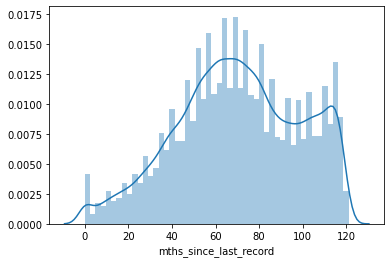

In [243]:
 sns.distplot(loan['mths_since_last_record'])

In [244]:
loan['mths_since_last_record'].describe()

count    82123.000000
mean        70.093068
std         28.139219
min          0.000000
25%         51.000000
50%         70.000000
75%         92.000000
max        121.000000
Name: mths_since_last_record, dtype: float64

In [245]:
print('Total Class Distribution :', round(100*loan['loan_status'].sum()/loan['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['mths_since_last_record']>0]
print('Total Class Distribution when mths_since_last_record is valued :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['mths_since_last_record']>70]
print('Total Class Distribution when mths_since_last_record is greater than Mean :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------

loantmp=loan[loan['mths_since_last_record'].isnull()]
print('Total Class Distribution when mths_since_last_record is null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------

Total Class Distribution : 23.63
Total Class Distribution when mths_since_last_record is valued : 19.0
Total Class Distribution when mths_since_last_record is greater than Mean : 22.34
Total Class Distribution when mths_since_last_record is null : 24.39


In [246]:
## Analysis of ' mths_since_last_major_derog   '

print('Total Class Distribution :', round(100*loan['loan_status'].sum()/loan['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['mths_since_last_major_derog']>0]
print('Total Class Distribution when mths_since_last_major_derog is valued :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['mths_since_last_major_derog']>70]
print('Total Class Distribution when mths_since_last_major_derog is greater than Mean :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
# df_6[df_6.isnull().any(axis=1)].head(10)
loantmp=loan[loan['mths_since_last_major_derog'].isnull()]
print('Total Class Distribution when mths_since_last_major_derog is null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[~loan['mths_since_last_major_derog'].isnull()]
print('Total Class Distribution when mths_since_last_major_derog is not null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

# This variable is useless and no harm removing it


Total Class Distribution : 23.63
Total Class Distribution when mths_since_last_major_derog is valued : 17.46
Total Class Distribution when mths_since_last_major_derog is greater than Mean : 16.81
Total Class Distribution when mths_since_last_major_derog is null : 25.69
Total Class Distribution when mths_since_last_major_derog is not null : 17.46


In [247]:
## Analysis of ' mths_since_last_delinq    '

print('Total Class Distribution :', round(100*loan['loan_status'].sum()/loan['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['mths_since_last_delinq']>0]
print('Total Class Distribution when mths_since_last_delinq is valued :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['mths_since_last_delinq']>70]
print('Total Class Distribution when mths_since_last_delinq is greater than Mean :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
# df_6[df_6.isnull().any(axis=1)].head(10)
loantmp=loan[loan['mths_since_last_delinq'].isnull()]
print('Total Class Distribution when mths_since_last_delinq is null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[~loan['mths_since_last_delinq'].isnull()]
print('Total Class Distribution when mths_since_last_delinq is not null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

# This variable is useless and no harm removing it


Total Class Distribution : 23.63
Total Class Distribution when mths_since_last_delinq is valued : 21.41
Total Class Distribution when mths_since_last_delinq is greater than Mean : 23.46
Total Class Distribution when mths_since_last_delinq is null : 25.67
Total Class Distribution when mths_since_last_delinq is not null : 21.5


In [248]:
# Dropping features 
loan.drop(['mths_since_last_major_derog','mths_since_last_record','mths_since_last_delinq'],axis=1,inplace=True)

In [249]:
round((loan.isnull().sum()/len(loan) * 100),2).sort_values(ascending=False).head(10)

batch_enrolled                15.99
tot_cur_bal                    7.89
tot_coll_amt                   7.89
total_rev_hi_lim               7.89
emp_title                      5.79
emp_length                     5.05
revol_util                     0.05
collections_12_mths_ex_med     0.02
title                          0.02
loan_status                    0.00
dtype: float64

In [250]:
loan['batch_enrolled'].describe()

count     447279
unique       104
top             
freq      106079
Name: batch_enrolled, dtype: object

In [251]:
#104 Unique values is too large and useless 
loan.drop('batch_enrolled',axis=1,inplace=True)

In [252]:
loan['tot_cur_bal'].describe()

count    4.904240e+05
mean     1.395541e+05
std      1.539149e+05
min      0.000000e+00
25%      2.983975e+04
50%      8.066950e+04
75%      2.084792e+05
max      8.000078e+06
Name: tot_cur_bal, dtype: float64

In [253]:
## Analysis of ' tot_cur_bal    '

print('Total Class Distribution :', round(100*loan['loan_status'].sum()/loan['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['tot_cur_bal']==0]
print('Total Class Distribution when tot_cur_bal is zero :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[loan['tot_cur_bal'].isnull()]
print('Total Class Distribution when tot_cur_bal is null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[~loan['tot_cur_bal'].isnull()]
print('Total Class Distribution when tot_cur_bal is not null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))


Total Class Distribution : 23.63
Total Class Distribution when tot_cur_bal is zero : 30.77
Total Class Distribution when tot_cur_bal is null : 79.34
Total Class Distribution when tot_cur_bal is not null : 18.86


In [254]:
# distribution of Loan wrt loan_status 

#------------------------------------------------------------------------
loantmp=loan[loan['tot_cur_bal']>loan['tot_cur_bal'].mean()]
print('Total Class Distribution when tot_cur_bal is greater than Mean :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

#------------------------------------------------------------------------
loantmp=loan[loan['tot_cur_bal']>loan['tot_cur_bal'].median()]
print('Total Class Distribution when tot_cur_bal is greater than Median :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

#------------------------------------------------------------------------
loantmp=loan[loan['tot_cur_bal']<loan['tot_cur_bal'].quantile(.1)]
print('Total Class Distribution when tot_cur_bal is lessthan than Q10 :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

#------------------------------------------------------------------------
loantmp=loan[(loan['tot_cur_bal']<loan['tot_cur_bal'].quantile(.3))&(loan['tot_cur_bal']>loan['tot_cur_bal'].quantile(.1))]
print('Total Class Distribution when tot_cur_bal is in between Q10--Q30 :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

#------------------------------------------------------------------------
loantmp=loan[(loan['tot_cur_bal']<loan['tot_cur_bal'].quantile(.7))&(loan['tot_cur_bal']>loan['tot_cur_bal'].quantile(.3))]
print('Total Class Distribution when tot_cur_bal is in between Q30--Q70 :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))


#------------------------------------------------------------------------
loantmp=loan[(loan['tot_cur_bal']<loan['tot_cur_bal'].quantile(.9))&(loan['tot_cur_bal']>loan['tot_cur_bal'].quantile(.7))]
print('Total Class Distribution when tot_cur_bal is in between Q70--Q90 :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))


#------------------------------------------------------------------------
loantmp=loan[(loan['tot_cur_bal']>loan['tot_cur_bal'].quantile(.9))]
print('Total Class Distribution when tot_cur_bal is in greater than Q90 :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))


Total Class Distribution when tot_cur_bal is greater than Mean : 19.95
Total Class Distribution when tot_cur_bal is greater than Median : 19.49
Total Class Distribution when tot_cur_bal is lessthan than Q10 : 20.17
Total Class Distribution when tot_cur_bal is in between Q10--Q30 : 18.49
Total Class Distribution when tot_cur_bal is in between Q30--Q70 : 17.83
Total Class Distribution when tot_cur_bal is in between Q70--Q90 : 20.13
Total Class Distribution when tot_cur_bal is in greater than Q90 : 19.9


In [255]:
# since there is no correlation between tot_cur_bal and loan_status so I will replace these three variables with binary 1 or 0 

def isitnull(x):    
    if pd.isnull(x):
        return 0
    else: 
        return 1
loan['tot_cur_bal']=loan['tot_cur_bal'].apply(isitnull)
loan['tot_coll_amt']=loan['tot_cur_bal'].apply(isitnull)
loan['total_rev_hi_lim']=loan['tot_cur_bal'].apply(isitnull)


In [256]:
loan['emp_title'].describe()

count      501595
unique     190124
top       Teacher
freq         8280
Name: emp_title, dtype: object

In [257]:
#since there are lot of discrete values this variable is useless 
loan.drop('emp_title',axis=1,inplace=True)


In [258]:
loan['emp_length'].describe()

count        505537
unique           11
top       10+ years
freq         175105
Name: emp_length, dtype: object

In [259]:
## Analysis of ' emp_length    '
print('Total Class Distribution :', round(100*loan['loan_status'].sum()/loan['loan_status'].count(),2))

#------------------------------------------------------------------------
loantmp=loan[loan['emp_length'].isnull()]
print('Total Class Distribution when emp_length is null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
#------------------------------------------------------------------------
loantmp=loan[~loan['emp_length'].isnull()]
print('Total Class Distribution when emp_length is not null :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))

#------------------------------------------------------------------------
loantmp=loan[loan['emp_length']=='10+ years']
print('Total Class Distribution when emp_length is mode :', round(100*loantmp['loan_status'].sum()/loantmp['loan_status'].count(),2))
# total Current balance Null is a stong  indicator of customer defualting their loans


Total Class Distribution : 23.63
Total Class Distribution when emp_length is null : 16.69
Total Class Distribution when emp_length is not null : 24.0
Total Class Distribution when emp_length is mode : 21.94


In [260]:
count_prospects_marital = loan.groupby('emp_length')['loan_status'].sum().reset_index(name = 'count_prospects')
No_of_prospect_job = loan.groupby('emp_length')['loan_status'].count().reset_index(name = 'No_of_prospects')
agg_marital = count_prospects_marital.merge(No_of_prospect_job, on = 'emp_length')
agg_marital['response_rate'] = 100*(agg_marital['count_prospects']/agg_marital['No_of_prospects']).round(4)
agg_marital

,emp_length,count_prospects,No_of_prospects,response_rate
0,1 year,8534,34202,24.95
1,10+ years,38421,175105,21.94
2,2 years,11835,47276,25.03
3,3 years,10199,42175,24.18
4,4 years,8140,31581,25.77
5,5 years,8923,33393,26.72
6,6 years,7238,25741,28.12
7,7 years,6938,26680,26.00
8,8 years,5971,26443,22.58
9,9 years,4747,20688,22.95


In [261]:
loan["emp_length"].fillna("10+ years", inplace = True)

In [262]:
count_prospects_marital = loan.groupby('emp_length')['loan_status'].sum().reset_index(name = 'count_prospects')
No_of_prospect_job = loan.groupby('emp_length')['loan_status'].count().reset_index(name = 'No_of_prospects')
agg_marital = count_prospects_marital.merge(No_of_prospect_job, on = 'emp_length')
agg_marital['response_rate'] = 100*(agg_marital['count_prospects']/agg_marital['No_of_prospects']).round(4)
agg_marital

,emp_length,count_prospects,No_of_prospects,response_rate
0,1 year,8534,34202,24.95
1,10+ years,42909,201996,21.24
2,2 years,11835,47276,25.03
3,3 years,10199,42175,24.18
4,4 years,8140,31581,25.77
5,5 years,8923,33393,26.72
6,6 years,7238,25741,28.12
7,7 years,6938,26680,26.00
8,8 years,5971,26443,22.58
9,9 years,4747,20688,22.95


In [263]:
# using dropna() function  
loan1=loan.dropna()
print(round(100*len(loan1)/len(loan),2))
print("Data Loss :",100-round(100*len(loan1)/len(loan),2))
loan=loan1

99.92
Data Loss : 0.0799999999999983


In [264]:
loan.shape

(531976, 38)

### Exploratory Data Analysis of Measures (Numerical Columns) & Dimensions (Catagorical)

In [265]:
# Features segregation
allcols=loan.columns.tolist()
# allcols
measures=loan.describe().columns.tolist()
measures
dimensions=[x for x in allcols if x not in measures]
dimensions


['member_id',
 'loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'int_rate',
 'annual_inc',
 'dti',
 'delinq_2yrs',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'collections_12_mths_ex_med',
 'acc_now_delinq',
 'tot_coll_amt',
 'tot_cur_bal',
 'total_rev_hi_lim',
 'loan_status']

['term',
 'grade',
 'sub_grade',
 'emp_length',
 'home_ownership',
 'verification_status',
 'pymnt_plan',
 'purpose',
 'title',
 'zip_code',
 'addr_state',
 'initial_list_status',
 'application_type',
 'last_week_pay']

#### NOTE: Due to low time Constrains I will look at Few of these data instead of all 

In [266]:
loan[measures].head()

,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
0,58189336,14350,14350,14350.0,19.19,28700.0,33.88,0.0,1.0,14.0,1.0,22515.0,73.1,28.0,1173.84,0.0,0.0,0.0,0.0,0.0,1,1,1,0
1,70011223,4800,4800,4800.0,10.99,65000.0,3.64,0.0,1.0,6.0,0.0,7624.0,23.2,13.0,83.95,0.0,0.0,0.0,0.0,0.0,1,1,1,0
2,70255675,10000,10000,10000.0,7.26,45000.0,18.42,0.0,0.0,5.0,0.0,10877.0,31.2,19.0,56.47,0.0,0.0,0.0,0.0,0.0,1,1,1,0
3,1893936,15000,15000,15000.0,19.72,105000.0,14.97,0.0,2.0,10.0,0.0,13712.0,55.5,21.0,4858.62,0.0,0.0,0.0,0.0,0.0,1,1,1,0
4,7652106,16000,16000,16000.0,10.64,52000.0,20.16,0.0,0.0,11.0,0.0,35835.0,76.2,27.0,2296.41,0.0,0.0,0.0,0.0,0.0,1,1,1,0


In [267]:
df1=loan[measures[1:]].describe()
df1

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,531976.000000,531976.000000,531976.000000,531976.000000,5.319760e+05,531976.000000,531976.000000,531976.000000,531976.000000,531976.000000,5.319760e+05,531976.000000,531976.000000,531976.000000,531976.000000,531976.000000,531976.000000,531976.000000,531976.000000,531976.0,531976.000000,531976.0,531976.000000
mean,14760.204596,14746.966076,14708.522322,13.242254,7.502097e+04,18.142209,0.314332,0.694520,11.549318,0.194905,1.692419e+04,55.059606,25.271069,1753.831227,0.393731,45.701483,4.853547,0.014303,0.005012,1.0,0.921325,1.0,0.236225
std,8433.077501,8427.805393,8439.002832,4.379603,6.518736e+04,8.367924,0.859852,0.996315,5.309953,0.583779,2.240675e+04,23.851957,11.842371,2093.320255,4.084726,409.612774,63.078007,0.133029,0.079102,0.0,0.269230,0.0,0.424762
min,500.000000,500.000000,0.000000,5.320000,1.200000e+03,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,8000.000000,8000.000000,8000.000000,9.990000,4.500000e+04,11.930000,0.000000,0.000000,8.000000,0.000000,6.452000e+03,37.700000,17.000000,441.957500,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,13000.000000,13000.000000,13000.000000,12.990000,6.500000e+04,17.660000,0.000000,0.000000,11.000000,0.000000,1.188100e+04,56.000000,24.000000,1073.130000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,20000.000000,20000.000000,20000.000000,16.200000,9.000000e+04,23.950000,0.000000,1.000000,14.000000,0.000000,2.084700e+04,73.600000,32.000000,2235.345000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,35000.000000,35000.000000,35000.000000,28.990000,9.500000e+06,672.520000,30.000000,31.000000,90.000000,86.000000,2.568995e+06,892.300000,162.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,14.000000,1.0,1.000000,1.0,1.000000


In [268]:
# 1 Member-ID
loan.drop('member_id',axis=1,inplace=True)

0.6811676205423777

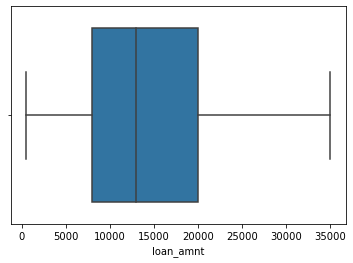

In [269]:
#2 Loan Amount 
loan['loan_amnt'].skew()
sns.boxplot(loan['loan_amnt'])

0.6811676205423777

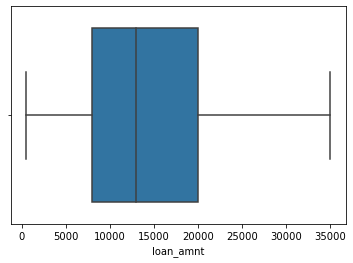

In [270]:
#2 Loan Amount 
loan['loan_amnt'].skew()
sns.boxplot(loan['loan_amnt'])

44.83417633695496

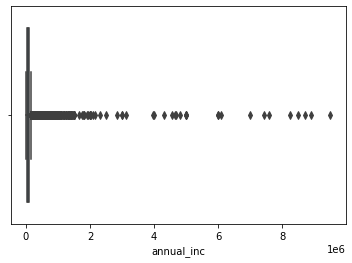

In [271]:
#3 annual_inc
loan['annual_inc'].skew()
sns.boxplot(loan['annual_inc'])


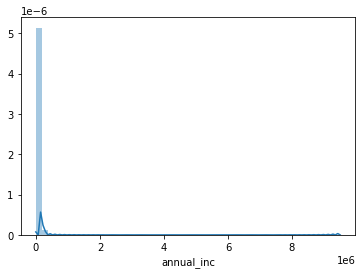

In [272]:
sns.distplot(loan['annual_inc'])

0.21410096401709486

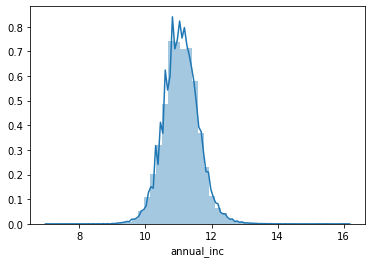

In [273]:
temp=np.log(loan['annual_inc'])
temp.skew()
loan['annual_inc']=temp
sns.distplot(loan['annual_inc'])

1.2909434731025828

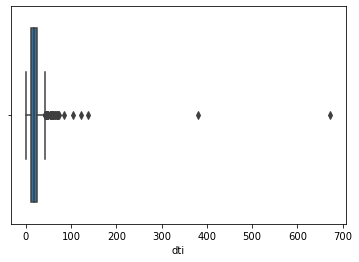

In [274]:
# 4 dti
loan['dti'].skew()
sns.boxplot(loan['dti'])


In [275]:
# removing Outliers 
outval=0.99
loan_tmp=loan[loan.dti<loan.dti.quantile(outval)]

print("Data Loss at Q",outval," is:",100-100*len(loan_tmp)/len(loan))
print("Q",outval,'Is :',loan.dti.quantile(outval))


Data Loss at Q 0.99  is: 1.0036167045129787
Q 0.99 Is : 37.47


0.16074935560784825

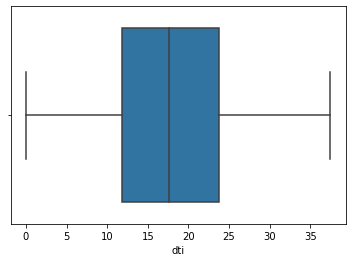

In [276]:
loan=loan_tmp
loan['dti'].skew()
sns.boxplot(loan['dti'])


In [277]:
loan[measures[1:]].describe()


,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,5.266370e+05,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.0,526637.000000,526637.0,526637.000000
mean,14768.188002,14754.815271,14716.081752,13.217743,11.078062,17.930690,0.314184,0.696201,11.525197,0.194979,1.687568e+04,54.996715,25.235437,1759.916690,0.395730,46.034635,4.881371,0.014258,0.004994,1.0,0.920528,1.0,0.238075
std,8438.499524,8433.189928,8444.575822,4.379161,0.527553,8.075694,0.859620,0.998050,5.298714,0.584389,2.240214e+04,23.864642,11.832306,2099.691184,4.097254,411.183339,63.300589,0.132888,0.078978,0.0,0.270475,0.0,0.425906
min,500.000000,500.000000,0.000000,5.320000,7.547502,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,8000.000000,8000.000000,8000.000000,9.990000,10.714418,11.870000,0.000000,0.000000,8.000000,0.000000,6.434000e+03,37.600000,17.000000,443.310000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,13000.000000,13000.000000,13000.000000,12.990000,11.082143,17.550000,0.000000,0.000000,11.000000,0.000000,1.184900e+04,55.900000,24.000000,1077.060000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,20000.000000,20000.000000,20000.000000,15.990000,11.407565,23.730000,0.000000,1.000000,14.000000,0.000000,2.077800e+04,73.500000,32.000000,2243.280000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,35000.000000,35000.000000,35000.000000,28.990000,16.066802,37.460000,30.000000,31.000000,90.000000,86.000000,2.568995e+06,892.300000,162.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,14.000000,1.0,1.000000,1.0,1.000000


5.380774205749096

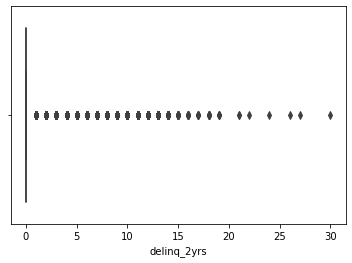

In [278]:
# delinq_2yrs  : number of 30+ days delinquency in past 2years

loan['delinq_2yrs'].skew()
sns.boxplot(loan['delinq_2yrs'])


In [279]:
loan['delinq_2yrs'].value_counts()

0.0     425476
1.0      67227
2.0      19922
3.0       7175
4.0       3118
5.0       1597
6.0        891
7.0        444
8.0        264
9.0        165
10.0       114
11.0        73
12.0        59
13.0        37
14.0        27
15.0        14
16.0         9
18.0         8
17.0         6
19.0         4
21.0         2
30.0         1
22.0         1
26.0         1
27.0         1
24.0         1
Name: delinq_2yrs, dtype: int64

In [280]:
loan['delinq_2yrs'][loan['delinq_2yrs']>5.0] =5.0

In [281]:
loan['delinq_2yrs'].value_counts()

0.0    425476
1.0     67227
2.0     19922
3.0      7175
5.0      3719
4.0      3118
Name: delinq_2yrs, dtype: int64

In [282]:
# Created a function to display distribution
def prospect(i):
    count_prospects_marital = loan.groupby(i)['loan_status'].sum().reset_index(name = 'total_defaults')
    No_of_prospect_job = loan.groupby(i)['loan_status'].count().reset_index(name = 'Total_Records')
    agg_marital = count_prospects_marital.merge(No_of_prospect_job, on = i)
    agg_marital['default_rate'] = 100*(agg_marital['total_defaults']/agg_marital['Total_Records']).round(4)
    print(agg_marital)
    ax = sns.barplot(x=i, y='default_rate', data=agg_marital)
    ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
    plt.show()


   delinq_2yrs  total_defaults  Total_Records  default_rate
0          0.0          105497         425476         24.80
1          1.0           13839          67227         20.59
2          2.0            3816          19922         19.15
3          3.0            1217           7175         16.96
4          4.0             472           3118         15.14
5          5.0             538           3719         14.47


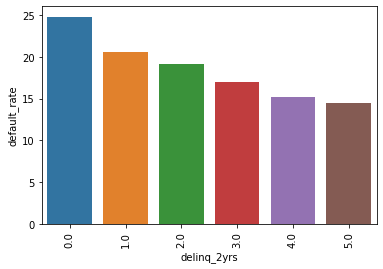

In [283]:
prospect('delinq_2yrs')

In [284]:
import warnings
warnings.filterwarnings('ignore')
pd.options.display.max_columns = 150
pd.options.display.max_rows = 100


In [285]:
loan[measures[1:]].describe()

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,5.266370e+05,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.000000,526637.0,526637.000000,526637.0,526637.000000
mean,14768.188002,14754.815271,14716.081752,13.217743,11.078062,17.930690,0.303175,0.696201,11.525197,0.194979,1.687568e+04,54.996715,25.235437,1759.916690,0.395730,46.034635,4.881371,0.014258,0.004994,1.0,0.920528,1.0,0.238075
std,8438.499524,8433.189928,8444.575822,4.379161,0.527553,8.075694,0.762198,0.998050,5.298714,0.584389,2.240214e+04,23.864642,11.832306,2099.691184,4.097254,411.183339,63.300589,0.132888,0.078978,0.0,0.270475,0.0,0.425906
min,500.000000,500.000000,0.000000,5.320000,7.547502,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,8000.000000,8000.000000,8000.000000,9.990000,10.714418,11.870000,0.000000,0.000000,8.000000,0.000000,6.434000e+03,37.600000,17.000000,443.310000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,13000.000000,13000.000000,13000.000000,12.990000,11.082143,17.550000,0.000000,0.000000,11.000000,0.000000,1.184900e+04,55.900000,24.000000,1077.060000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,20000.000000,20000.000000,20000.000000,15.990000,11.407565,23.730000,0.000000,1.000000,14.000000,0.000000,2.077800e+04,73.500000,32.000000,2243.280000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,35000.000000,35000.000000,35000.000000,28.990000,16.066802,37.460000,5.000000,31.000000,90.000000,86.000000,2.568995e+06,892.300000,162.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,14.000000,1.0,1.000000,1.0,1.000000


In [286]:
#6 inq_last_6mths : 

# loan['inq_last_6mths'].head()
loan['inq_last_6mths'].skew()
loan['inq_last_6mths'].value_counts()

2.0236650889368724

0.0     295285
1.0     143195
2.0      55904
3.0      22395
4.0       6496
5.0       2394
6.0        718
7.0         99
8.0         79
9.0         23
10.0        14
11.0         9
12.0         8
15.0         5
14.0         2
18.0         2
16.0         2
24.0         2
13.0         1
31.0         1
17.0         1
28.0         1
20.0         1
Name: inq_last_6mths, dtype: int64

In [287]:
loan['inq_last_6mths'][loan['inq_last_6mths']>5.0] =5.0
loan['inq_last_6mths'].skew()
loan['inq_last_6mths'].value_counts()

1.6440167739077256

0.0    295285
1.0    143195
2.0     55904
3.0     22395
4.0      6496
5.0      3362
Name: inq_last_6mths, dtype: int64

   inq_last_6mths  total_defaults  Total_Records  default_rate
0             0.0           62539         295285         21.18
1             1.0           35440         143195         24.75
2             2.0           16510          55904         29.53
3             3.0            7505          22395         33.51
4             4.0            2076           6496         31.96
5             5.0            1309           3362         38.94


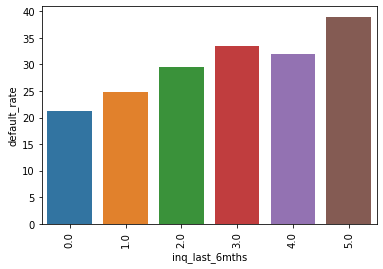

In [288]:
prospect('inq_last_6mths')

1.2543788519176378

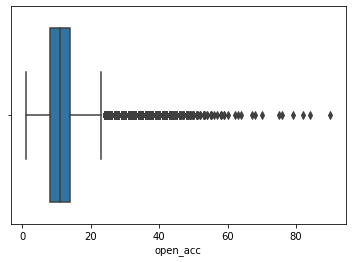

In [289]:
# open_acc	number of open credit line in member's credit line
loan['open_acc'].skew()
sns.boxplot(loan['open_acc'])



In [290]:
# removing Outliers 
outval=0.99
var='open_acc'
loan_tmp=loan[loan[var]<loan[var].quantile(outval)]
print("Q",outval,'Is :',loan[var].quantile(outval),' And Max value is :',loan[var].quantile(1))
print("Data Loss at Q",outval," is:",100-100*len(loan_tmp)/len(loan))



Q 0.99 Is : 28.0  And Max value is : 90.0
Data Loss at Q 0.99  is: 1.1770916209837168


0.7362580721202185

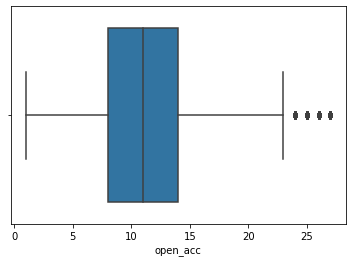

In [291]:
loan=loan_tmp
loan['open_acc'].skew()
sns.boxplot(loan['open_acc'])


In [292]:
loan[measures[1:]].describe()


,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,5.204380e+05,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.000000,520438.0,520438.000000,520438.0,520438.000000
mean,14727.001103,14713.481193,14674.545555,13.216823,11.074936,17.874115,0.302330,0.688361,11.280512,0.195357,1.672219e+04,55.117607,24.888603,1760.105235,0.397092,46.191532,4.894273,0.014201,0.004957,1.0,0.919764,1.0,0.239404
std,8421.582370,8416.141341,8427.460542,4.375331,0.526997,8.066719,0.760846,0.973801,4.800548,0.584757,2.195372e+04,23.861365,11.381988,2100.342870,4.097975,411.789377,63.405286,0.132740,0.078428,0.0,0.271659,0.0,0.426720
min,500.000000,500.000000,0.000000,5.320000,7.547502,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,8000.000000,8000.000000,8000.000000,9.990000,10.714418,11.820000,0.000000,0.000000,8.000000,0.000000,6.398000e+03,37.700000,16.000000,443.430000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,13000.000000,13000.000000,12950.000000,12.990000,11.082143,17.480000,0.000000,0.000000,11.000000,0.000000,1.176900e+04,56.000000,23.000000,1077.305000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,20000.000000,20000.000000,20000.000000,15.990000,11.407565,23.650000,0.000000,1.000000,14.000000,0.000000,2.060400e+04,73.600000,32.000000,2243.085000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,35000.000000,35000.000000,35000.000000,28.990000,16.066802,37.460000,5.000000,5.000000,27.000000,86.000000,2.568995e+06,892.300000,156.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,14.000000,1.0,1.000000,1.0,1.000000


15.443777588674541

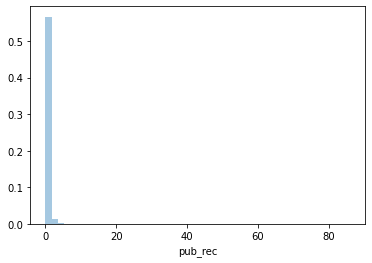

In [293]:
#8 pub_rec : number of derogatory public records
var='pub_rec'
loan[var].skew()
sns.distplot(loan[var])

In [294]:
# removing Outliers 
outval=0.999
var='pub_rec'
loan_tmp=loan[loan[var]<loan[var].quantile(outval)]
print("Q",outval,'Is :',loan[var].quantile(outval),' And Max value is :',loan[var].quantile(1))
print("Data Loss at Q",outval," is:",100-100*len(loan_tmp)/len(loan))


Q 0.999 Is : 5.0  And Max value is : 86.0
Data Loss at Q 0.999  is: 0.17350769928405896


3.3138572708092013

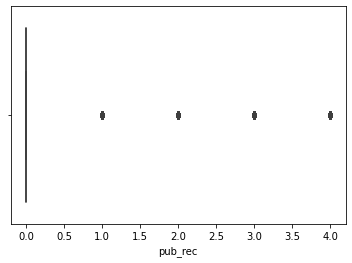

In [295]:
loan=loan_tmp
loan[var].skew()
sns.boxplot(loan[var])

   pub_rec  total_defaults  Total_Records  default_rate
0      0.0          109288         440713         24.80
1      1.0           13577          66549         20.40
2      2.0            1213           8659         14.01
3      3.0             336           2651         12.67
4      4.0             106            963         11.01


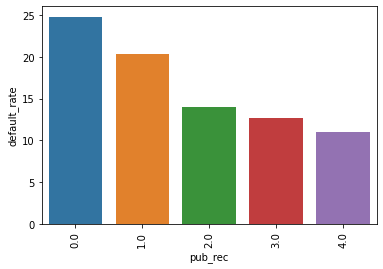

In [296]:
prospect(var)

In [297]:

loan[measures[10:]].describe()

,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,519535.000000,5.195350e+05,519535.000000,519535.000000,519535.000000,519535.000000,519535.000000,519535.000000,519535.000000,519535.000000,519535.0,519535.000000,519535.0,519535.000000
mean,0.184149,1.673146e+04,55.128165,24.892094,1760.595907,0.397351,46.218841,4.898073,0.014188,0.004956,1.0,0.919626,1.0,0.239676
std,0.486242,2.195492e+04,23.862580,11.383751,2100.804237,4.100087,411.753459,63.438425,0.132713,0.078411,0.0,0.271871,0.0,0.426886
min,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,0.000000,6.403000e+03,37.700000,17.000000,443.750000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,0.000000,1.177700e+04,56.000000,23.000000,1077.720000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,0.000000,2.061700e+04,73.700000,32.000000,2243.685000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,4.000000,2.568995e+06,892.300000,156.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,14.000000,1.0,1.000000,1.0,1.000000


-0.09192159173331366

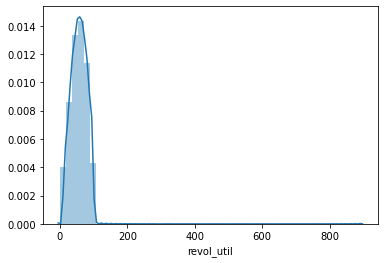

In [298]:
#9 revol_util

var='revol_util'
loan[var].skew()
sns.distplot(loan[var])

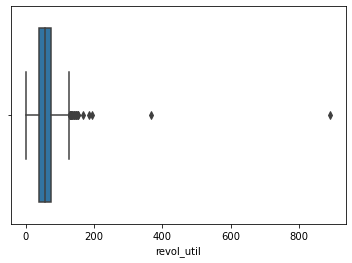

In [299]:
sns.boxplot(loan[var])

In [300]:
# removing Outliers 
outval=0.995
var='revol_util'
loan_tmp=loan[loan[var]<loan[var].quantile(outval)]
print("Q",outval,'Is :',loan[var].quantile(outval),' And Max value is :',loan[var].quantile(1))
print("Data Loss at Q",outval," is:",100-100*len(loan_tmp)/len(loan))


Q 0.995 Is : 99.70000000000002  And Max value is : 892.3
Data Loss at Q 0.995  is: 0.49082352488282766


-0.19710989341777937

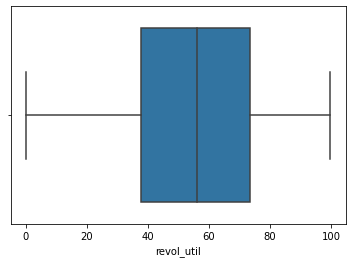

In [301]:
loan=loan_tmp
loan[var].skew()
sns.boxplot(loan[var])

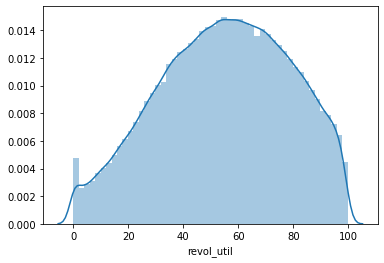

In [302]:
sns.distplot(loan[var])

In [303]:
loan[measures[13:]].describe()

,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,516985.000000,516985.000000,516985.000000,516985.000000,516985.000000,516985.000000,516985.000000,516985.0,516985.000000,516985.0,516985.000000
mean,24.920369,1761.072342,0.396053,46.264436,4.898743,0.014231,0.004946,1.0,0.919321,1.0,0.240276
std,11.382714,2100.875739,4.091738,412.113533,63.493786,0.132923,0.078137,0.0,0.272342,0.0,0.427251
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,17.000000,444.220000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,23.000000,1077.990000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,32.000000,2244.320000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,156.000000,24205.620000,358.680000,33520.270000,7002.190000,16.000000,14.000000,1.0,1.000000,1.0,1.000000


0.7775109305618427

Q 0.99 Is : 58.0  And Max value is : 156.0
Data Loss at Q 0.99  is: 1.0145362051123357


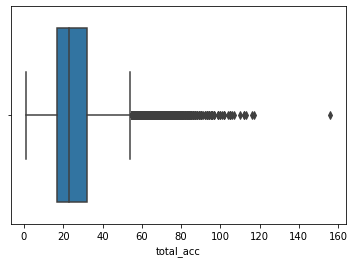

In [304]:
# 10 Total_acc
var='total_acc'
loan[var].skew()
sns.boxplot(loan[var])
# removing Outliers 
outval=0.99
loan_tmp=loan[loan[var]<loan[var].quantile(outval)]
print("Q",outval,'Is :',loan[var].quantile(outval),' And Max value is :',loan[var].quantile(1))
print("Data Loss at Q",outval," is:",100-100*len(loan_tmp)/len(loan))


0.519617163272615

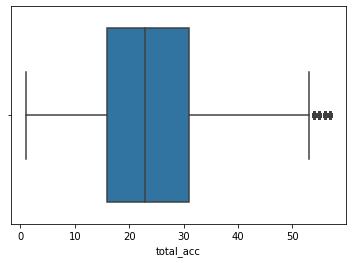

In [305]:
loan=loan_tmp
loan[var].skew()
sns.boxplot(loan[var])


In [306]:
temp=np.log(loan[var])
temp.skew()
temp1=np.sqrt(loan[var])
temp1.skew()

-0.6493647105736374

-0.010004846201761864

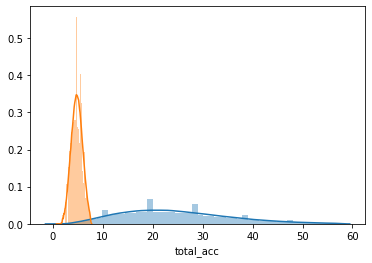

In [307]:
sns.distplot(loan[var])
loan[var]=temp1
sns.distplot(loan[var])

In [308]:
loan[measures[13:]].describe()

,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,511740.000000,511740.000000,511740.000000,511740.000000,511740.000000,511740.000000,511740.000000,511740.0,511740.000000,511740.0,511740.000000
mean,4.828412,1758.564895,0.396027,46.137965,4.877381,0.014191,0.004903,1.0,0.919096,1.0,0.240063
std,1.100218,2097.753116,4.086170,410.787323,63.381033,0.131097,0.077840,0.0,0.272688,0.0,0.427122
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,4.000000,443.760000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,4.795832,1076.615000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,5.567764,2240.942500,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,7.549834,24205.620000,358.680000,33520.270000,7002.190000,14.000000,14.000000,1.0,1.000000,1.0,1.000000


2.830624064763048

Q 0.99 Is : 10273.570799999996  And Max value is : 24205.62
Data Loss at Q 0.99  is: 1.0001172470395119


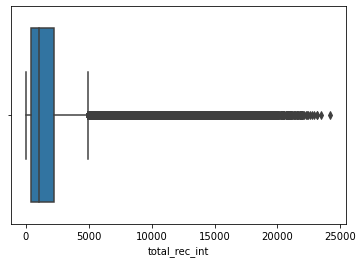

In [309]:
var='total_rec_int'
loan[var].skew()
sns.boxplot(loan[var])
# removing Outliers 
outval=0.99
loan_tmp=loan[loan[var]<loan[var].quantile(outval)]
print("Q",outval,'Is :',loan[var].quantile(outval),' And Max value is :',loan[var].quantile(1))
print("Data Loss at Q",outval," is:",100-100*len(loan_tmp)/len(loan))



1.9728705043366805

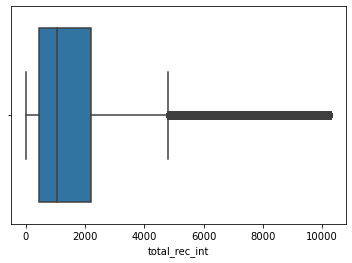

In [310]:
loan=loan_tmp
loan[var].skew()
sns.boxplot(loan[var])


In [311]:
temp=np.log(loan[var])
temp.skew()
temp1=np.sqrt(loan[var])
temp1.skew()

nan

0.7299992859676198

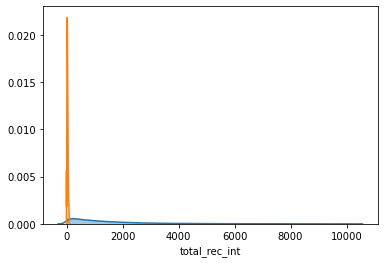

In [312]:
sns.distplot(loan[var])
loan[var]=temp1
sns.distplot(loan[var])

count    506622.000000
mean          0.375587
std           3.894932
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         294.680000
Name: total_rec_late_fee, dtype: float64

   total_rec_late_fee  total_defaults  Total_Records  default_rate
0                   0          120123         499681         24.04
1                   1            1637           6941         23.58


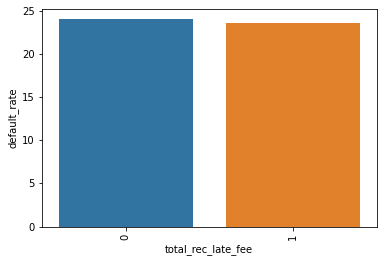

In [313]:
#12  total_rec_late_fee
var='total_rec_late_fee'
loan[var].describe()
# sns.boxplot(loan[var])
def isitzero(x):    
    if x==0:
        return 0
    else: 
        return 1
loan[var]=loan[var].apply(isitzero)
prospect(var)

count    506622.000000
mean         45.513296
std         407.404464
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       33520.270000
Name: recoveries, dtype: float64

   recoveries  total_defaults  Total_Records  default_rate
0           0          121760         492458         24.72
1           1               0          14164          0.00


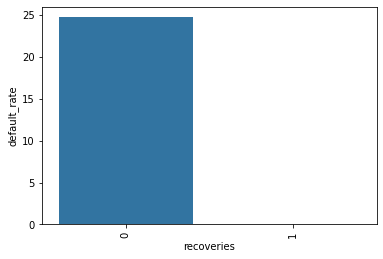

In [314]:
#recoveries
var='recoveries'
loan[var].describe()
loan[var]=loan[var].apply(isitzero)
prospect(var)

In [315]:
loan[measures[14:]].describe()

,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.0,506622.000000,506622.0,506622.000000
mean,35.460383,0.013701,0.027958,4.781709,0.014277,0.004899,1.0,0.920673,1.0,0.240337
std,19.679616,0.116245,0.164852,62.838012,0.131523,0.077842,0.0,0.270249,0.0,0.427289
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,20.949224,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,32.558255,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,46.761924,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,101.357782,1.000000,1.000000,7002.190000,14.000000,14.000000,1.0,1.000000,1.0,1.000000


   total_rec_late_fee  total_defaults  Total_Records  default_rate
0                   0          120123         499681         24.04
1                   1            1637           6941         23.58


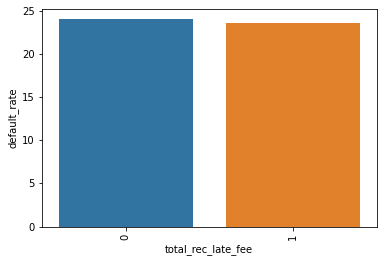

In [316]:
# total_rec_late_fee
prospect('total_rec_late_fee')

count    506622.000000
mean          4.781709
std          62.838012
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        7002.190000
Name: collection_recovery_fee, dtype: float64

   collection_recovery_fee  total_defaults  Total_Records  default_rate
0                        0          121760         493134         24.69
1                        1               0          13488          0.00


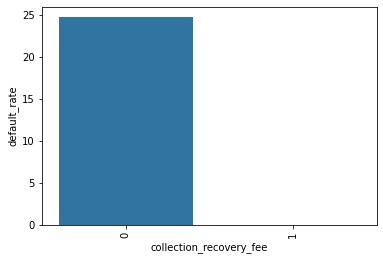

In [317]:
# collection_recovery_fee
var='collection_recovery_fee'
loan[var].describe()
loan[var]=loan[var].apply(isitzero)
prospect(var)

   tot_coll_amt  total_defaults  Total_Records  default_rate
0             1          121760         506622         24.03


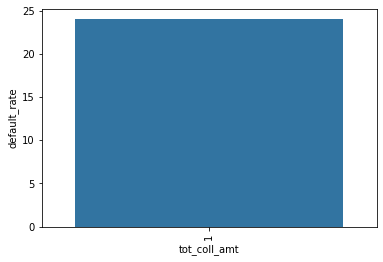

In [318]:
#tot_coll_amt

prospect('tot_coll_amt')

count    506622.000000
mean          0.004899
std           0.077842
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          14.000000
Name: acc_now_delinq, dtype: float64

   acc_now_delinq  total_defaults  Total_Records  default_rate
0               0          121434         504325         24.08
1               1             326           2297         14.19


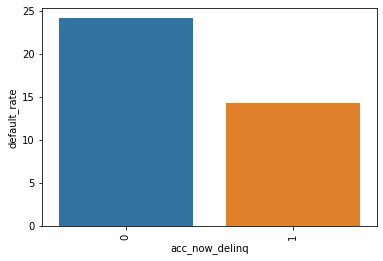

In [319]:
## acc_now_delinq
var='acc_now_delinq'

loan[var].describe()
loan[var]=loan[var].apply(isitzero)
prospect(var)

count    506622.000000
mean          0.014277
std           0.131523
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          14.000000
Name: collections_12_mths_ex_med, dtype: float64

   collections_12_mths_ex_med  total_defaults  Total_Records  default_rate
0                           0          121075         499979         24.22
1                           1             685           6643         10.31


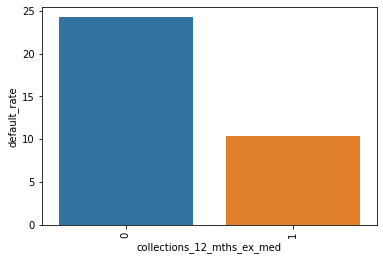

In [320]:
# collections_12_mths_ex_med

var='collections_12_mths_ex_med'
loan[var].describe()
loan[var]=loan[var].apply(isitzero)
prospect(var)

In [321]:
loan[dimensions].head()

,term,grade,sub_grade,emp_length,home_ownership,verification_status,pymnt_plan,purpose,title,zip_code,addr_state,initial_list_status,application_type,last_week_pay
0,36 months,E,E3,9 years,OWN,Source Verified,n,debt_consolidation,Debt consolidation,349xx,FL,f,INDIVIDUAL,26th week
1,36 months,B,B4,< 1 year,MORTGAGE,Source Verified,n,home_improvement,Home improvement,209xx,MD,w,INDIVIDUAL,9th week
2,36 months,A,A4,2 years,OWN,Not Verified,n,debt_consolidation,Debt consolidation,447xx,OH,w,INDIVIDUAL,9th week
3,36 months,D,D5,10+ years,RENT,Not Verified,n,debt_consolidation,Debt consolidation,221xx,VA,f,INDIVIDUAL,135th week
4,36 months,B,B2,10+ years,RENT,Verified,n,credit_card,refi,900xx,CA,w,INDIVIDUAL,96th week


14

        term  total_defaults  Total_Records  default_rate
0  36 months           99266         359538         27.61
1  60 months           22494         147084         15.29


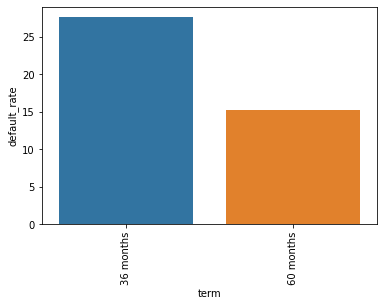

  grade  total_defaults  Total_Records  default_rate
0     A           23556          86832         27.13
1     B           39476         148250         26.63
2     C           31055         141170         22.00
3     D           17396          78123         22.27
4     E            7165          37865         18.92
5     F            2485          11752         21.15
6     G             627           2630         23.84


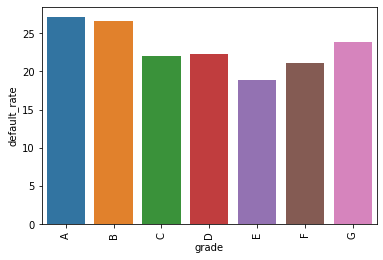

   sub_grade  total_defaults  Total_Records  default_rate
0         A1            3325          13276         25.05
1         A2            3540          13190         26.84
2         A3            4038          13741         29.39
3         A4            6090          20300         30.00
4         A5            6563          26325         24.93
5         B1            6497          26274         24.73
6         B2            7749          28612         27.08
7         B3            9339          32850         28.43
8         B4            8650          32164         26.89
9         B5            7241          28350         25.54
10        C1            7350          30882         23.80
11        C2            6997          30175         23.19
12        C3            6044          28737         21.03
13        C4            5516          27743         19.88
14        C5            5148          23633         21.78
15        D1            4458          20507         21.74
16        D2  

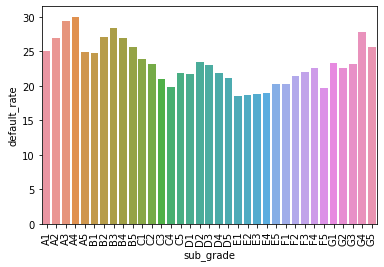

   emp_length  total_defaults  Total_Records  default_rate
0      1 year            8295          32697         25.37
1   10+ years           41318         191240         21.61
2     2 years           11450          45154         25.36
3     3 years            9891          40275         24.56
4     4 years            7912          30103         26.28
5     5 years            8676          31895         27.20
6     6 years            7032          24615         28.57
7     7 years            6727          25440         26.44
8     8 years            5791          25231         22.95
9     9 years            4609          19753         23.33
10   < 1 year           10059          40219         25.01


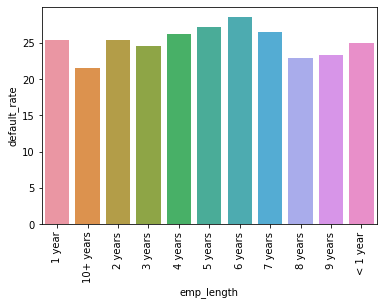

  home_ownership  total_defaults  Total_Records  default_rate
0            ANY               1              3         33.33
1       MORTGAGE           61113         251607         24.29
2           NONE              22             28         78.57
3          OTHER              89            115         77.39
4            OWN           10564          49918         21.16
5           RENT           49971         204951         24.38


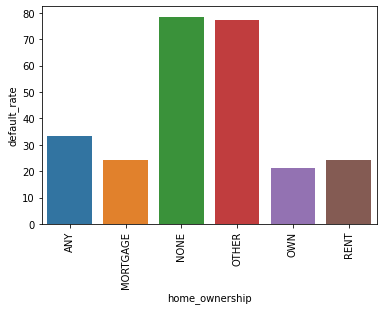

  verification_status  total_defaults  Total_Records  default_rate
0        Not Verified           44145         155017         28.48
1     Source Verified           35291         189603         18.61
2            Verified           42324         162002         26.13


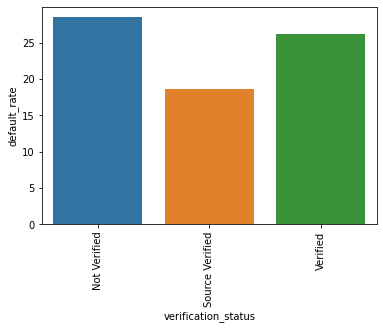

In [322]:
len(dimensions)
for i in dimensions[0:6]:
       prospect(i)

In [323]:
#  remove Subgrade
loan.drop('sub_grade',axis=1,inplace=True)

pymnt_plan
  pymnt_plan  total_defaults  Total_Records  default_rate
0          n          121758         506616         24.03
1          y               2              6         33.33


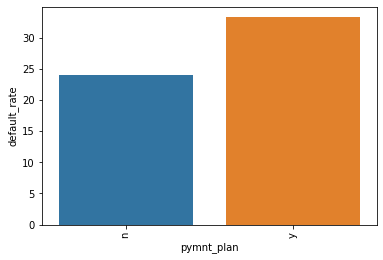

purpose
               purpose  total_defaults  Total_Records  default_rate
0                  car            1900           5129         37.04
1          credit_card           24750         118186         20.94
2   debt_consolidation           70468         298694         23.59
3          educational             194            246         78.86
4     home_improvement            7464          29575         25.24
5                house             809           2070         39.08
6       major_purchase            3211           9953         32.26
7              medical            1353           4899         27.62
8               moving             952           3112         30.59
9                other            6782          24551         27.62
10    renewable_energy             122            321         38.01
11      small_business            1975           5801         34.05
12            vacation             750           2720         27.57
13             wedding            1030  

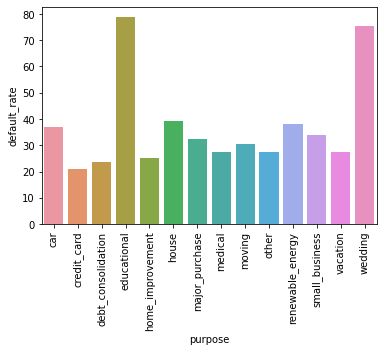

In [324]:
# len(dimensions)
for i in dimensions[6:8]:
       print(i)
       prospect(i)

zip_code
    zip_code  total_defaults  Total_Records  default_rate
0      007xx               0              2          0.00
1      008xx               1              3         33.33
2      010xx             213            863         24.68
3      011xx              49            235         20.85
4      012xx              38            196         19.39
..       ...             ...            ...           ...
910    995xx             176            616         28.57
911    996xx              70            273         25.64
912    997xx              55            236         23.31
913    998xx              29            102         28.43
914    999xx               7             35         20.00

[915 rows x 4 columns]


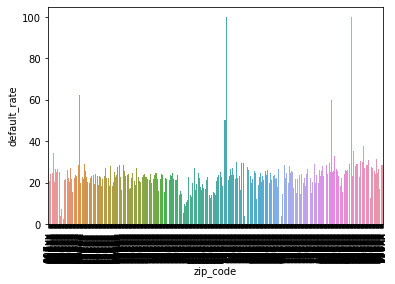

addr_state
   addr_state  total_defaults  Total_Records  default_rate
0          AK             343           1271         26.99
1          AL            1422           6301         22.57
2          AR             840           3755         22.37
3          AZ            2995          11866         25.24
4          CA           21119          75038         28.14
5          CO            2769          10708         25.86
6          CT            1739           7656         22.71
7          DC             445           1416         31.43
8          DE             318           1431         22.22
9          FL            8194          34869         23.50
10         GA            3853          16289         23.65
11         HI             709           2565         27.64
12         IA               5              7         71.43
13         ID               4              7         57.14
14         IL            4476          20081         22.29
15         IN            1220           7750 

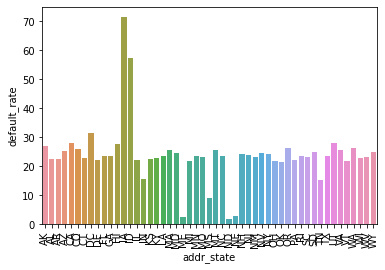

initial_list_status
  initial_list_status  total_defaults  Total_Records  default_rate
0                   f           87869         260526         33.73
1                   w           33891         246096         13.77


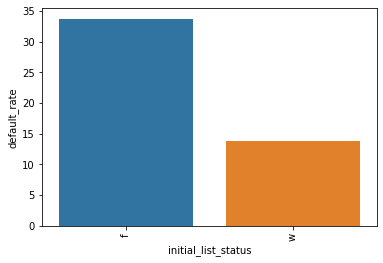

application_type
  application_type  total_defaults  Total_Records  default_rate
0       INDIVIDUAL          121760         506395         24.04
1            JOINT               0            227          0.00


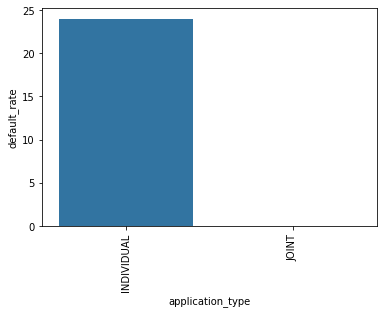

last_week_pay
   last_week_pay  total_defaults  Total_Records  default_rate
0       0th week             682            782         87.21
1     100th week            2490           7916         31.46
2     104th week            2276           7365         30.90
3     108th week             157            181         86.74
4     109th week            1995           7464         26.73
5     113th week            1857           6187         30.01
6     117th week            1611           6104         26.39
7     118th week             182            223         81.61
8     121th week             223            263         84.79
9     122th week            1457           5109         28.52
10    126th week            1524           5088         29.95
11    130th week             912           1661         54.91
12    131th week             551           3349         16.45
13    135th week            1410           4220         33.41
14    139th week            1243           3634         

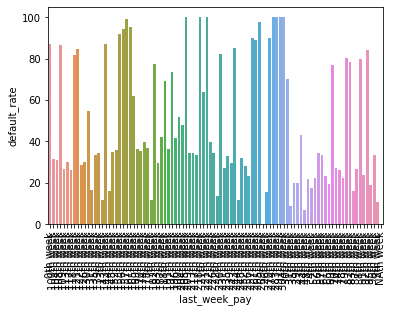

In [325]:
for i in dimensions[9:14]:
       print(i)
       prospect(i)

In [326]:
loan[dimensions[8]].value_counts()

Debt consolidation          236244
Credit card refinancing      94023
Home improvement             22924
Other                        18207
Debt Consolidation            9270
                             ...  
buying existing business         1
Relief aplenty                   1
Great Consolidate Loan           1
CitiBank Payoff                  1
new summer                       1
Name: title, Length: 38276, dtype: int64

In [327]:
loan.drop(['title','zip_code'],axis=1,inplace=True)


   last_week_pay  total_defaults  Total_Records  default_rate
0       0th week             682            782         87.21
1     100th week            2490           7916         31.46
2     104th week            2276           7365         30.90
3     108th week             157            181         86.74
4     109th week            1995           7464         26.73
5     113th week            1857           6187         30.01
6     117th week            1611           6104         26.39
7     118th week             182            223         81.61
8     121th week             223            263         84.79
9     122th week            1457           5109         28.52
10    126th week            1524           5088         29.95
11    130th week             912           1661         54.91
12    131th week             551           3349         16.45
13    135th week            1410           4220         33.41
14    139th week            1243           3634         34.20
15     1

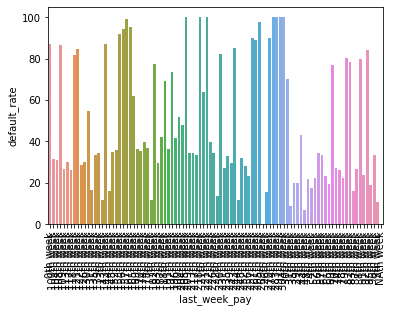

In [328]:
# last Week Pay : "indicates how long (in weeks) a member has paid EMI after batch enrolled"
# reducing the number of variables 
prospect('last_week_pay')

In [329]:
def get_bucket(x):
    z=x.split('th')[0]
    if z=='NA':
        n=0
    else:
        n=int(z)
            
    if (n>50)&(n<=150):
        r='50-150'
    elif (n>150) &(n<=250):
         r='150-250'
    elif n>250:
         r='250+'
    else:
        r='50-'     
    return r
tmp=loan['last_week_pay'].apply(get_bucket) 



  last_week_pay  total_defaults  Total_Records  default_rate
0       150-250           19766          24418         80.95
1          250+             518            682         75.95
2           50-           44225         270601         16.34
3        50-150           57251         210921         27.14


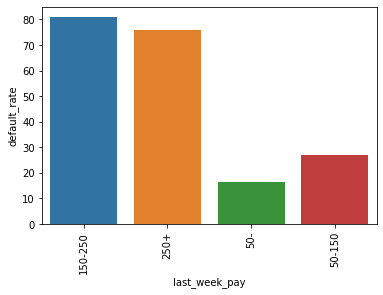

In [330]:
loan['last_week_pay']=tmp
prospect('last_week_pay')

In [331]:
# trimming Feature list 
measures

['member_id',
 'loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'int_rate',
 'annual_inc',
 'dti',
 'delinq_2yrs',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'collections_12_mths_ex_med',
 'acc_now_delinq',
 'tot_coll_amt',
 'tot_cur_bal',
 'total_rev_hi_lim',
 'loan_status']

In [332]:
measures.remove('member_id')

In [333]:
loan[measures].describe()

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status
count,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,5.066220e+05,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.000000,506622.0,506622.000000,506622.0,506622.000000
mean,14546.470939,14533.444610,14494.900736,13.121597,11.066978,17.840784,0.300222,0.680780,11.211025,0.185408,1.654726e+04,54.816767,4.824633,35.460383,0.013701,0.027958,0.026623,0.013112,0.004534,1.0,0.920673,1.0,0.240337
std,8289.455181,8284.687646,8296.761954,4.312379,0.525048,8.072347,0.757051,0.967093,4.732202,0.488011,2.165233e+04,23.632957,1.100669,19.679616,0.116245,0.164852,0.160980,0.113756,0.067182,0.0,0.270249,0.0,0.427289
min,500.000000,500.000000,0.000000,5.320000,7.547502,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,1.0,0.000000
25%,8000.000000,8000.000000,8000.000000,9.990000,10.714418,11.780000,0.000000,0.000000,8.000000,0.000000,6.349000e+03,37.600000,4.000000,20.949224,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
50%,12750.000000,12700.000000,12600.000000,12.990000,11.061233,17.440000,0.000000,0.000000,10.000000,0.000000,1.166100e+04,55.800000,4.795832,32.558255,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
75%,20000.000000,20000.000000,20000.000000,15.800000,11.407565,23.620000,0.000000,1.000000,14.000000,0.000000,2.035500e+04,73.200000,5.567764,46.761924,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.000000,1.0,0.000000
max,35000.000000,35000.000000,35000.000000,28.990000,16.066802,37.460000,5.000000,5.000000,27.000000,4.000000,2.568995e+06,99.700000,7.549834,101.357782,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.0,1.000000


In [334]:
x=['total_rec_late_fee','recoveries','collection_recovery_fee','collections_12_mths_ex_med','acc_now_delinq','tot_coll_amt','tot_cur_bal','total_rev_hi_lim','loan_status']

In [335]:
for i in x:
  measures.remove(i)

In [336]:
loan[measures].head()

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int
0,14350,14350,14350.0,19.19,10.264652,33.88,0.0,1.0,14.0,1.0,22515.0,73.1,5.291503,34.261348
1,4800,4800,4800.0,10.99,11.082143,3.64,0.0,1.0,6.0,0.0,7624.0,23.2,3.605551,9.162423
2,10000,10000,10000.0,7.26,10.714418,18.42,0.0,0.0,5.0,0.0,10877.0,31.2,4.358899,7.514652
3,15000,15000,15000.0,19.72,11.561716,14.97,0.0,2.0,10.0,0.0,13712.0,55.5,4.582576,69.703802
4,16000,16000,16000.0,10.64,10.858999,20.16,0.0,0.0,11.0,0.0,35835.0,76.2,5.196152,47.920872


In [337]:
loan_bckup=loan.copy()

In [338]:
loan_Cols=loan.columns.tolist()
loan_Cols

['loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'grade',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'pymnt_plan',
 'purpose',
 'addr_state',
 'dti',
 'delinq_2yrs',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'initial_list_status',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'collections_12_mths_ex_med',
 'application_type',
 'last_week_pay',
 'acc_now_delinq',
 'tot_coll_amt',
 'tot_cur_bal',
 'total_rev_hi_lim',
 'loan_status']

In [339]:
dimensions


['term',
 'grade',
 'sub_grade',
 'emp_length',
 'home_ownership',
 'verification_status',
 'pymnt_plan',
 'purpose',
 'title',
 'zip_code',
 'addr_state',
 'initial_list_status',
 'application_type',
 'last_week_pay']

In [340]:
dimensions.remove('sub_grade')
dimensions.remove('zip_code')
dimensions.remove('title')


In [341]:
loan[dimensions].head()

,term,grade,emp_length,home_ownership,verification_status,pymnt_plan,purpose,addr_state,initial_list_status,application_type,last_week_pay
0,36 months,E,9 years,OWN,Source Verified,n,debt_consolidation,FL,f,INDIVIDUAL,50-
1,36 months,B,< 1 year,MORTGAGE,Source Verified,n,home_improvement,MD,w,INDIVIDUAL,50-
2,36 months,A,2 years,OWN,Not Verified,n,debt_consolidation,OH,w,INDIVIDUAL,50-
3,36 months,D,10+ years,RENT,Not Verified,n,debt_consolidation,VA,f,INDIVIDUAL,50-150
4,36 months,B,10+ years,RENT,Verified,n,credit_card,CA,w,INDIVIDUAL,50-150


In [342]:
loan_bckup=loan.copy()

In [343]:
loan.shape

(506622, 34)

In [344]:
# creating Dummy Variables for Features 
for j in dimensions:
    print(j)
    dummy = pd.get_dummies(loan[j],prefix=j,drop_first=True)
    loan = pd.concat([loan,dummy],axis=1)
    loan.drop(j,axis=1,inplace=True)


term
grade
emp_length
home_ownership
verification_status
pymnt_plan
purpose
addr_state
initial_list_status
application_type
last_week_pay


In [345]:
loan.head()

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,loan_status,term_60 months,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,emp_length_10+ years,emp_length_2 years,emp_length_3 years,emp_length_4 years,emp_length_5 years,emp_length_6 years,emp_length_7 years,emp_length_8 years,emp_length_9 years,emp_length_< 1 year,home_ownership_MORTGAGE,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,verification_status_Source Verified,verification_status_Verified,pymnt_plan_y,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding,addr_state_AL,addr_state_AR,addr_state_AZ,addr_state_CA,addr_state_CO,addr_state_CT,addr_state_DC,addr_state_DE,addr_state_FL,addr_state_GA,addr_state_HI,addr_state_IA,addr_state_ID,addr_state_IL,addr_state_IN,addr_state_KS,addr_state_KY,addr_state_LA,addr_state_MA,addr_state_MD,addr_state_ME,addr_state_MI,addr_state_MN,addr_state_MO,addr_state_MS,addr_state_MT,addr_state_NC,addr_state_ND,addr_state_NE,addr_state_NH,addr_state_NJ,addr_state_NM,addr_state_NV,addr_state_NY,addr_state_OH,addr_state_OK,addr_state_OR,addr_state_PA,addr_state_RI,addr_state_SC,addr_state_SD,addr_state_TN,addr_state_TX,addr_state_UT,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,initial_list_status_w,application_type_JOINT,last_week_pay_250+,last_week_pay_50-,last_week_pay_50-150
0,14350,14350,14350.0,19.19,10.264652,33.88,0.0,1.0,14.0,1.0,22515.0,73.1,5.291503,34.261348,0,0,0,0,0,1,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,4800,4800,4800.0,10.99,11.082143,3.64,0.0,1.0,6.0,0.0,7624.0,23.2,3.605551,9.162423,0,0,0,0,0,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
2,10000,10000,10000.0,7.26,10.714418,18.42,0.0,0.0,5.0,0.0,10877.0,31.2,4.358899,7.514652,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
3,15000,15000,15000.0,19.72,11.561716,14.97,0.0,2.0,10.0,0.0,13712.0,55.5,4.582576,69.703802,0,0,0,0,0,1,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
4,16000,16000,16000.0,10.64,10.858999,20.16,0.0,0.0,11.0,0.0,35835.0,76.2,5.196152,47.920872,0,0,0,0,0,1,1,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1


In [346]:
# Import library to split the dataset into test and train

from sklearn.model_selection import train_test_split

In [347]:
# Putting feature variable to X
X = loan.drop(['loan_status'],axis=1)

# Putting response variable to y
y = loan['loan_status']

In [348]:
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X,y, train_size=0.7,test_size=0.3,random_state=100)

In [349]:
# scaling 
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train[measures] = scaler.fit_transform(X_train[measures])
X_test[measures] = scaler.transform(X_test[measures])

In [350]:
# garbage collect (unused) object
import gc # for deleting unused variables
gc.collect()

49596

In [351]:
X_train.head()

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,term_60 months,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,emp_length_10+ years,emp_length_2 years,emp_length_3 years,emp_length_4 years,emp_length_5 years,emp_length_6 years,emp_length_7 years,emp_length_8 years,emp_length_9 years,emp_length_< 1 year,home_ownership_MORTGAGE,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,verification_status_Source Verified,verification_status_Verified,pymnt_plan_y,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding,addr_state_AL,addr_state_AR,addr_state_AZ,addr_state_CA,addr_state_CO,addr_state_CT,addr_state_DC,addr_state_DE,addr_state_FL,addr_state_GA,addr_state_HI,addr_state_IA,addr_state_ID,addr_state_IL,addr_state_IN,addr_state_KS,addr_state_KY,addr_state_LA,addr_state_MA,addr_state_MD,addr_state_ME,addr_state_MI,addr_state_MN,addr_state_MO,addr_state_MS,addr_state_MT,addr_state_NC,addr_state_ND,addr_state_NE,addr_state_NH,addr_state_NJ,addr_state_NM,addr_state_NV,addr_state_NY,addr_state_OH,addr_state_OK,addr_state_OR,addr_state_PA,addr_state_RI,addr_state_SC,addr_state_SD,addr_state_TN,addr_state_TX,addr_state_UT,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,initial_list_status_w,application_type_JOINT,last_week_pay_250+,last_week_pay_50-,last_week_pay_50-150
135009,-1.209097,-1.208241,-1.201776,-0.101256,-1.042738,-0.020254,6.234153,-0.703227,0.380276,-0.381447,-0.115880,0.282507,1.143752,-1.317197,0,0,0,0,0,1,1,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
529559,-0.789713,-0.788612,-0.782747,-0.003821,0.031303,-0.786015,-0.396347,0.330462,-0.889998,-0.381447,-0.561963,-0.787748,-0.025588,0.361124,0,0,0,0,0,1,0,1,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
212237,-0.210420,-0.208980,-0.203945,0.279203,-0.894134,1.296904,-0.396347,0.330462,-1.101711,-0.381447,-0.183579,1.145479,-1.979207,0.803921,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
297983,0.344736,0.346501,0.350740,0.274563,-0.287122,0.135872,-0.396347,-0.703227,1.438837,-0.381447,-0.442937,0.138678,0.593545,0.542730,0,0,0,0,0,1,1,1,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
431108,-0.572478,-0.571250,-0.566156,0.771015,-0.384091,0.489014,-0.396347,4.465222,-0.889998,1.667484,-0.528805,0.819749,-0.121371,1.307585,0,0,0,0,0,1,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Model Building 



In [362]:
# Model 1 :  Logistic Regression 
#-------------------------------------------

# importing library for model preparation
from sklearn.linear_model import LinearRegression, Lasso, Ridge, LogisticRegression
from sklearn.metrics import roc_auc_score,f1_score,accuracy_score

lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred_lrp = lr.predict_proba(X_test)
y_pred_lr = lr.predict(X_test)

LogisticRegression()

In [368]:
rc=roc_auc_score(y_test, y_pred_lrp[:,1])
f1=f1_score(y_test, y_pred_lr)
acc=accuracy_score(y_test, y_pred_lr)

tempResults = pd.DataFrame({'Method':['Basic Linear Regression'], 'ROC-AUC': [rc],'F1-Score': [f1],'Accuracy':[acc] })
results = tempResults
results

,Method,ROC-AUC,F1-Score,Accuracy
0,Basic Linear Regression,0.816226,0.502919,0.825794


In [371]:
# try some Regularizations 
num_C = [0.5,1,10,30]
for i in num_C:
    lr_2 = LogisticRegression(C=i, class_weight=None, dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=100, multi_class='auto', n_jobs=-1, penalty='l2',
                   random_state=1000, verbose=0,
                   warm_start=False)
    lr_2.fit(X_train, y_train)
    y_pred_os = lr_2.predict_proba(X_test)
    print('C:',i,'ROC Score',roc_auc_score(y_test, y_pred_os[:,1]))

LogisticRegression(C=0.5, n_jobs=-1, random_state=1000)

C : 0.5 ROC Score 0.8162550573734647


LogisticRegression(C=1, n_jobs=-1, random_state=1000)

C : 1 ROC Score 0.816226323700268


LogisticRegression(C=10, n_jobs=-1, random_state=1000)

C : 10 ROC Score 0.8161961812089696


LogisticRegression(C=30, n_jobs=-1, random_state=1000)

C : 30 ROC Score 0.8161765476750618


In [372]:
# Model 2 :  Logistic Regression with PCA
#-------------------------------------------
# importing library for model preparation

from sklearn.decomposition import PCA
pca = PCA()
pca.fit(X_train)
pca_file = pca.fit_transform(X_train)

PCA()

<Figure size 630x360 with 0 Axes>

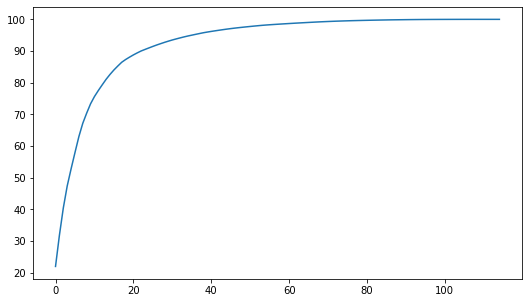

In [373]:
# plot feature variance
features = range(pca.n_components_)
cumulative_variance = np.round(np.cumsum(pca.explained_variance_ratio_)*100, decimals=4)
plt.figure(figsize=(175/20,100/20)) # 100 elements on y-axis; 175 elements on x-axis; 20 is normalising factor
plt.plot(cumulative_variance)

In [393]:
#90% of variance is explained by 25 variables 
pc2 = PCA(n_components=40, random_state=42)
X_train_PCA = pc2.fit_transform(X_train)
x_test_PCA =  pc2.transform(X_test)


In [394]:
X_train_PCA.shape
x_test_PCA.shape

(354635, 40)

(151987, 40)

In [395]:

lr2 = LogisticRegression()
lr2.fit(X_train_PCA, y_train)
y_pred_lrp = lr2.predict_proba(x_test_PCA)
y_pred_lr = lr2.predict(x_test_PCA)


LogisticRegression()

In [396]:
rc=roc_auc_score(y_test, y_pred_lrp[:,1])
f1=f1_score(y_test, y_pred_lr)
acc=accuracy_score(y_test, y_pred_lr)

tempResults = pd.DataFrame({'Method':['Basic Linear Regression PCA '], 'ROC-AUC': [rc],'F1-Score': [f1],'Accuracy':[acc] })
results = pd.concat([tempResults,results])
results

,Method,ROC-AUC,F1-Score,Accuracy
0,Basic Linear Regression PCA,0.787465,0.455080,0.820577
0,Basic Linear Regression PCA,0.742713,0.333449,0.785620
0,Basic Linear Regression,0.742713,0.333449,0.785620
0,Basic Linear Regression,0.816226,0.502919,0.825794


In [397]:
# Model 3 :   Random Forest non PCA 
#-------------------------------------------
# importing library for model preparation

from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

skf = StratifiedKFold(n_splits=3)
param_grid = {'max_depth': [4,8,10],
          'n_estimators': [100,200, 300]}
folds = 5
# specify model
RF = RandomForestClassifier(n_jobs=-1,class_weight='balanced')  

# set up GridSearchCV()
model_cv = GridSearchCV(estimator = RF, 
                        param_grid = param_grid, 
                        scoring= 'roc_auc', 
                        cv = StratifiedKFold(n_splits=5, shuffle=True), 
                        verbose = 2,
                        n_jobs=-1,
                        return_train_score=True)  

model_cv.fit(X_train, y_train)



Fitting 5 folds for each of 9 candidates, totalling 45 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed: 12.6min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed: 12.6min finished


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(class_weight='balanced',
                                              n_jobs=-1),
             n_jobs=-1,
             param_grid={'max_depth': [4, 8, 10],
                         'n_estimators': [100, 200, 300]},
             return_train_score=True, scoring='roc_auc', verbose=2)

In [405]:

model_cv.best_score_
model_cv.best_estimator_

{'max_depth': 10, 'n_estimators': 300}

0.7937321855881393

RandomForestClassifier(class_weight='balanced', max_depth=10, n_estimators=300,
                       n_jobs=-1)

In [406]:
RF_final=RandomForestClassifier(max_depth=10,n_estimators=300)
RF_final.fit(X_train,y_train)
y_pred_rfp = RF_final.predict_proba(X_test)
y_pred_rf = RF_final.predict(X_test)


RandomForestClassifier(max_depth=10, n_estimators=300)

In [409]:
results=results.iloc[[0,2,5],:]

In [407]:
rc=roc_auc_score(y_test, y_pred_rfp[:,1])
f1=f1_score(y_test, y_pred_rf)
acc=accuracy_score(y_test, y_pred_rf)

tempResults = pd.DataFrame({'Method':['Random FOrest non PCA '], 'ROC-AUC': [rc],'F1-Score': [f1],'Accuracy':[acc] })
results = pd.concat([results,tempResults])
results

,Method,ROC-AUC,F1-Score,Accuracy
0,Basic Linear Regression PCA,0.787465,0.455080,0.820577
0,Basic Linear Regression PCA,0.742713,0.333449,0.785620
0,Basic Linear Regression,0.742713,0.333449,0.785620
0,Basic Linear Regression,0.816226,0.502919,0.825794
0,"Random FOrest 10,100",0.790794,0.415086,0.818577
0,Random FOrest non PCA,0.793383,0.414506,0.818458


In [411]:
# Model 4 :   Random Forest with PCA 
#-------------------------------------------
# importing library for model preparation

skf = StratifiedKFold(n_splits=3)
param_grid = {'max_depth': [4,8,10],
          'n_estimators': [100,200, 300]}
folds = 5
# specify model
RF = RandomForestClassifier(n_jobs=-1,class_weight='balanced')  

# set up GridSearchCV()
model_cv = GridSearchCV(estimator = RF, 
                        param_grid = param_grid, 
                        scoring= 'roc_auc', 
                        cv = StratifiedKFold(n_splits=5, shuffle=True), 
                        verbose = 2,
                        n_jobs=-1,
                        return_train_score=True)  

model_cv.fit(X_train_PCA, y_train)


Fitting 5 folds for each of 9 candidates, totalling 45 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed: 10.6min
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed: 33.6min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed: 33.6min finished


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(class_weight='balanced',
                                              n_jobs=-1),
             n_jobs=-1,
             param_grid={'max_depth': [4, 8, 10],
                         'n_estimators': [100, 200, 300]},
             return_train_score=True, scoring='roc_auc', verbose=2)

In [412]:
model_cv.best_estimator_
model_cv.best_score_


RandomForestClassifier(class_weight='balanced', max_depth=10, n_estimators=300,
                       n_jobs=-1)

0.7883356703953401

In [413]:
RF_final=model_cv.best_estimator_
RF_final.fit(X_train_PCA,y_train)


RandomForestClassifier(class_weight='balanced', max_depth=10, n_estimators=300,
                       n_jobs=-1)

NameError: name 'X_test_PCA' is not defined

In [414]:
y_pred_rfp = RF_final.predict_proba(x_test_PCA)
y_pred_rf = RF_final.predict(x_test_PCA)
rc=roc_auc_score(y_test, y_pred_rfp[:,1])
f1=f1_score(y_test, y_pred_rf)
acc=accuracy_score(y_test, y_pred_rf)

tempResults = pd.DataFrame({'Method':['Random FOrest with PCA '], 'ROC-AUC': [rc],'F1-Score': [f1],'Accuracy':[acc] })
results = pd.concat([results,tempResults])
results

,Method,ROC-AUC,F1-Score,Accuracy
0,Basic Linear Regression PCA,0.787465,0.455080,0.820577
0,Basic Linear Regression,0.742713,0.333449,0.785620
0,Random FOrest non PCA,0.793383,0.414506,0.818458
0,Random FOrest with PCA,0.787912,0.541153,0.762901


In [418]:
# MODEL 5 : XGBOOST with PCA
#-------------------------------------------

import xgboost as xgb
from xgboost import XGBClassifier

#perform hyperparameter tuning
param_grid = {'learning_rate': [0.2, 0.6], 
          'subsample': [0.3, 0.6, 0.9],
          'max_depth' : [2,3,5]
          }          
# specify model
xgb_model_os = XGBClassifier(n_estimators=200)

# set up GridSearchCV()
model_cv_os = GridSearchCV(estimator = xgb_model_os, 
                          param_grid = param_grid, 
                          scoring= 'roc_auc', 
                          cv = StratifiedKFold  (n_splits=3, shuffle=True), 
                          verbose = 2,
                          n_jobs=-1,
                          return_train_score=True)  
model_cv_os.fit(X_train_PCA, y_train)

model_cv_os.best_estimator_
model_cv_os.best_score_



Fitting 3 folds for each of 18 candidates, totalling 54 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed: 15.0min
[Parallel(n_jobs=-1)]: Done  54 out of  54 | elapsed: 41.3min finished


GridSearchCV(cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     miss...s=None,
                                     n_estimators=200, n_jobs=None,
                                     num_parallel_tree=None, random_state=None,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                    

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.2, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=200, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.9,
              tree_method='exact', validate_parameters=1, verbosity=None)

0.8200315537374611

In [419]:
XGB_final=model_cv_os.best_estimator_
XGB_final.fit(X_train_PCA,y_train)


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.2, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=200, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.9,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [420]:
y_pred_xgp = RF_final.predict_proba(x_test_PCA)
y_pred_xg = RF_final.predict(x_test_PCA)
rc=roc_auc_score(y_test, y_pred_xgp[:,1])
f1=f1_score(y_test, y_pred_xg)
acc=accuracy_score(y_test, y_pred_xg)

tempResults = pd.DataFrame({'Method':['XGBoost with PCA '], 'ROC-AUC': [rc],'F1-Score': [f1],'Accuracy':[acc] })
results = pd.concat([results,tempResults])
results

,Method,ROC-AUC,F1-Score,Accuracy
0,Basic Linear Regression PCA,0.787465,0.455080,0.820577
0,Basic Linear Regression,0.742713,0.333449,0.785620
0,Random FOrest non PCA,0.793383,0.414506,0.818458
0,Random FOrest with PCA,0.787912,0.541153,0.762901
0,XGBoost with PCA,0.787912,0.541153,0.762901


In [421]:
# MODEL 6 : Simple Neural Networks 
#-------------------------------------------

import keras
from keras import backend as K
from keras.models import Sequential
from keras.layers import Activation
from keras.layers.core import Dense
from keras.optimizers import Adam
from keras.metrics import categorical_crossentropy

n_inputs = X_train.shape[1]

NN_model = Sequential([
    Dense(n_inputs, input_shape=(n_inputs, ), activation='relu'),
    Dense(32, activation='relu'),
    Dense(2, activation='softmax')
])

In [422]:
NN_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 115)               13340     
_________________________________________________________________
dense_1 (Dense)              (None, 32)                3712      
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 66        
Total params: 17,118
Trainable params: 17,118
Non-trainable params: 0
_________________________________________________________________


In [426]:
NN_model.compile(Adam(lr=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])


In [427]:
NN_model.fit(X_train, y_train, validation_split=0.3, batch_size=25, epochs=20, shuffle=True, verbose=2)

Epoch 1/20
9930/9930 - 10s - loss: 0.4090 - accuracy: 0.8251 - val_loss: 0.3929 - val_accuracy: 0.8348
Epoch 2/20
9930/9930 - 9s - loss: 0.3874 - accuracy: 0.8379 - val_loss: 0.3884 - val_accuracy: 0.8384
Epoch 3/20
9930/9930 - 9s - loss: 0.3806 - accuracy: 0.8418 - val_loss: 0.3819 - val_accuracy: 0.8413
Epoch 4/20
9930/9930 - 9s - loss: 0.3760 - accuracy: 0.8444 - val_loss: 0.3797 - val_accuracy: 0.8428
Epoch 5/20
9930/9930 - 9s - loss: 0.3726 - accuracy: 0.8459 - val_loss: 0.3802 - val_accuracy: 0.8436
Epoch 6/20
9930/9930 - 9s - loss: 0.3699 - accuracy: 0.8471 - val_loss: 0.3780 - val_accuracy: 0.8437
Epoch 7/20
9930/9930 - 9s - loss: 0.3673 - accuracy: 0.8480 - val_loss: 0.3788 - val_accuracy: 0.8432
Epoch 8/20
9930/9930 - 10s - loss: 0.3654 - accuracy: 0.8489 - val_loss: 0.3794 - val_accuracy: 0.8447
Epoch 9/20
9930/9930 - 9s - loss: 0.3633 - accuracy: 0.8496 - val_loss: 0.3814 - val_accuracy: 0.8434
Epoch 10/20
9930/9930 - 9s - loss: 0.3612 - accuracy: 0.8506 - val_loss: 0.3813 

In [433]:
y_pred_nn = NN_model.predict(X_test)
roc_auc_score(y_test, y_pred_nn[:,1])
f1= 'NA'
acc='NA'

tempResults = pd.DataFrame({'Method':['Neural Networks '], 'ROC-AUC': [rc],'F1-Score': [f1],'Accuracy':[acc] })
results = pd.concat([results,tempResults])
results

0.8341167676367881

,Method,ROC-AUC,F1-Score,Accuracy
0,Basic Linear Regression PCA,0.787465,0.455080,0.820577
0,Basic Linear Regression,0.742713,0.333449,0.78562
0,Random FOrest non PCA,0.793383,0.414506,0.818458
0,Random FOrest with PCA,0.787912,0.541153,0.762901
0,XGBoost with PCA,0.787912,0.541153,0.762901
0,Neural Networks,0.834117,0.541153,NA
